In [31]:
from datetime import date
from IPython.display import Markdown, display

display(Markdown(f"""
# Run API

**Author:** Anthony Hauser<br>
**Affiliation:** Unisanté<br>
**Date:** {date.today()}<br>
**Project:** Omata

**Aim**: load images and run IA models through API to assess whether they show tobacco products

1) load libraries

The python script is partially based on : https://mljar.com/notebooks/openai-vision-local-image/?utm_source=chatgpt.com.

https://docs.together.ai/docs/inference-python
"""))


# Run API

**Author:** Anthony Hauser<br>
**Affiliation:** Unisanté<br>
**Date:** 2025-11-06<br>
**Project:** Omata

**Aim**: load images and run IA models through API to assess whether they show tobacco products

1) load libraries

The python script is partially based on : https://mljar.com/notebooks/openai-vision-local-image/?utm_source=chatgpt.com.

https://docs.together.ai/docs/inference-python


In [26]:
#load libraries and environment variables

#library
import os
import io
from dotenv import load_dotenv
from openai import OpenAI, AuthenticationError
import base64
import requests

#env variables
load_dotenv()
api_key=os.getenv("OPENAI_API_KEY") # get api key from environment


# create OpenAI client
def create_client(api_key):
    try:
        client = OpenAI(api_key=api_key)
        client.models.list()#sanity check listing all availabel model
        return client
    except AuthenticationError:
        print("Incorrect API")
    return None
    
# Function to encode a single image
def encode_image(image_path):
    with open(image_path, "rb") as f:
        return base64.b64encode(f.read()).decode("utf-8")

#def resize_encode_image(image_path, resize=None):
    # Open image
#    img = Image.open(image_path)
    
    # Resize if requested
#    if resize is not None:
#        img.thumbnail((resize, resize))
        
    # Encode bytes to base64 string
 #   return base64.b64encode(img.tobytes()).decode("utf-8")

def resize_encode_image(image_path, resize=None):
    # Open image
    img = Image.open(image_path)
    
    # Resize if requested
    if resize is not None:
        img.thumbnail((resize, resize))
    
    # Save to bytes buffer in standard format (PNG)
    buffer = io.BytesIO()
    img.save(buffer, format="PNG")
    img_bytes = buffer.getvalue()
    
    # Encode to base64
    return base64.b64encode(img_bytes).decode("utf-8")


In [32]:
#load API 
client = create_client(api_key)

models = client.models.list()

# Print model IDs
for model in models.data:
    print(model.id)

model_name_list= ["gpt-4o-mini", "gpt-4o"]

dall-e-2
omni-moderation-latest
gpt-4o-mini-search-preview
o3-mini-2025-01-31
gpt-4o-mini-search-preview-2025-03-11
gpt-4-turbo
gpt-4.1
gpt-4.1-mini-2025-04-14
gpt-5-nano-2025-08-07
gpt-4.1-mini
sora-2
sora-2-pro
gpt-4-turbo-2024-04-09
text-embedding-3-small
gpt-realtime-mini
o3-2025-04-16
o4-mini-2025-04-16
gpt-4.1-2025-04-14
gpt-4o-2024-05-13
gpt-4o-search-preview-2025-03-11
gpt-4o-search-preview
gpt-3.5-turbo-16k
o1-mini
o1-mini-2024-09-12
tts-1-1106
gpt-4o-mini-2024-07-18
o3
o4-mini
gpt-5-chat-latest
gpt-5-nano
babbage-002
gpt-4-turbo-preview
chatgpt-4o-latest
tts-1-hd-1106
gpt-4o-mini-tts
o1-pro-2025-03-19
dall-e-3
o1
davinci-002
tts-1-hd
o1-pro
gpt-4o-2024-11-20
gpt-4-0125-preview
gpt-5-mini
gpt-5-mini-2025-08-07
gpt-4o-realtime-preview-2024-12-17
gpt-image-1
text-embedding-ada-002
gpt-4o-mini
o3-mini
gpt-5
gpt-4.1-nano-2025-04-14
gpt-4.1-nano
gpt-4o-realtime-preview-2025-06-03
gpt-4o-transcribe
gpt-3.5-turbo-instruct
gpt-3.5-turbo-instruct-0914
gpt-4-1106-preview
gpt-5-codex
gpt

# Images

We load 3 sets of images
- Positive controls
  - Images used in the pilot studies, collected from different sources (Social network, advertising, etc.)
- Negative controls
  - Instagram
  - Other sources

## Positive controls 
### Pilot study batch
Images from the pilot study.

In [21]:
#load and check dimension

from PIL import Image
from pathlib import Path
import pandas as pd

# Folder containing images
image_folder = Path(r"C:/TEMP/projects/omata/data/image_positive_controls/Images_test-20240424T090736Z-001/Images_test")

# Get all image paths
image_paths = list(image_folder.glob("*.jpg")) + \
              list(image_folder.glob("*.jpeg")) + \
              list(image_folder.glob("*.png"))
image_paths.sort()

# Extract file names, open images, and get sizes
file_names_pos1 = [p.name for p in image_paths]
image_sizes = [Image.open(p).size for p in image_paths]  # (width, height)

# Create a DataFrame
df_images = pd.DataFrame({
    "file_name": file_names_pos1,
    "width": [s[0] for s in image_sizes],
    "height": [s[1] for s in image_sizes]
})

# Display the DataFrame
print(df_images)

   file_name  width  height
0      1.jpg   2405    3608
1     10.jpg   5061    3447
2     11.jpg   1280     960
3     12.png   1160    1160
4     13.jpg    512     384
5     14.jpg   2630    3682
6     15.jpg   4032    3024
7     16.jpg   4000    5521
8     17.JPG   4000    3000
9     18.jpg    945    1261
10    19.jpg   1065     996
11     2.jpg   2767    1847
12    20.jpg    384     512
13    21.jpg   3456    5184
14    22.PNG   1319     871
15    23.PNG   1108     797
16    24.png    506     868
17    25.png    779     516
18    26.png    728     545
19    27.png    864     553
20    28.png    744     512
21    29.png    476     839
22     3.jpg    502     671
23    30.png    512     879
24    31.jpg    754    1293
25    32.png    552     882
26    33.png    510     887
27    34.jpg    959     708
28    35.png    747     377
29    36.jpg   1000     452
30    36.PNG    647     428
31    37.jpg   1200     902
32    37.PNG   1865     896
33    38.jpg   1200     902
34    38.png    373 

Found 46 images.


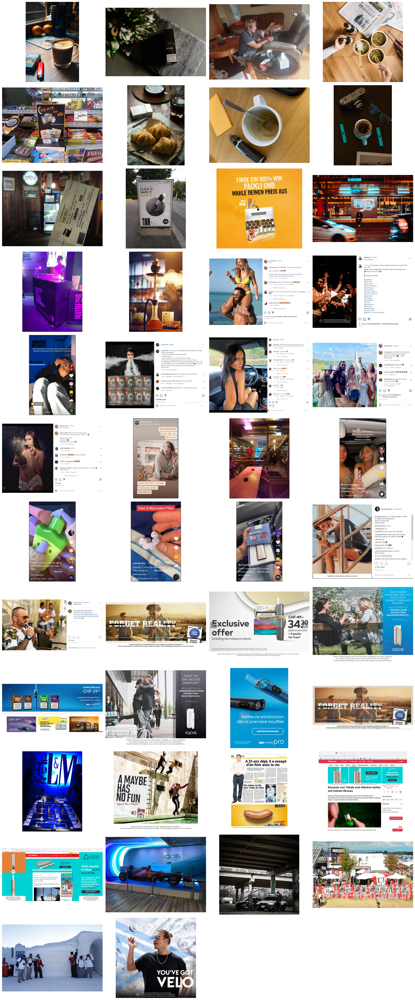

In [28]:
#convert to base64 and print

import matplotlib.pyplot as plt
import math

# Encode all images into a list
base64_images_pos1 = [resize_encode_image(path,resize=2000) for path in image_paths]#[encode_image(path) for path in image_paths]
num_images = len(base64_images_pos1)
print(f"Found {num_images} images.")

# Example: base64_images is your list of base64-encoded images
cols = 4  # adjust depending on number of images
rows = rows = math.ceil(num_images / cols)

plt.figure(figsize=(20, 4 * rows))
for idx, b64_img in enumerate(base64_images_pos1):
    # Decode base64 to image
    image_data = base64.b64decode(b64_img)
    image = Image.open(io.BytesIO(image_data))
    
    plt.subplot(rows, cols, idx + 1)
    plt.imshow(image)
    plt.axis('off')

plt.tight_layout()
plt.show()

## Negative controls 
### Instagram
28 Images from Instagram collected from
- accounts listed in https://hypeauditor.com/fr/top-instagram-all-switzerland/ (tobacco category)
- hashtags selecting objects or situations that are mirrored in tobacco advertising or promotion

Up to now, images are printscreened, check https://console.apify.com/actors/shu8hvrXbJbY3Eb9W/input?addFromActorId=shu8hvrXbJbY3Eb9W for higher quality data collection.

In [29]:
#load and check dimension

# Folder containing images
image_folder = Path(r"C:/TEMP/projects/omata/data/image_negative_controls/instagram_batch1")

# Get all image paths
image_paths = list(image_folder.glob("*.jpg")) + \
              list(image_folder.glob("*.jpeg")) + \
              list(image_folder.glob("*.png"))
image_paths.sort()

# Extract file names, open images, and get sizes
file_names_neg1 = [p.name for p in image_paths]
image_sizes = [Image.open(p).size for p in image_paths]  # (width, height)

# Create a DataFrame
df_images = pd.DataFrame({
    "file_name": file_names_neg1,
    "width": [s[0] for s in image_sizes],
    "height": [s[1] for s in image_sizes]
})

# Display the DataFrame
print(df_images)

                                file_name  width  height
0              instagram_airpodscases.png   1388     887
1                  instagram_altoids1.png   1390     892
2                  instagram_altoids2.png   1215     892
3                  instagram_altoids3.png   1395     894
4                  instagram_annacafe.png   1392     903
5           instagram_becandlesaikung.png   1391     892
6                 instagram_burtsbees.png    992     888
7   instagram_canadianlungassociation.png   1213     890
8              instagram_cigarqataris.png   1171     900
9                 instagram_file_tech.png   1390     853
10               instagram_globepapel.png   1389     896
11             instagram_hanirahmalia.png   1210     889
12      instagram_ichikoichie_incense.png   1211     895
13                   instagram_lacasa.png   1245     895
14              instagram_luisakempke.png   1158     892
15             instagram_mnemonic_bar.png   1362     835
16                instagram_nag

Found 28 images.


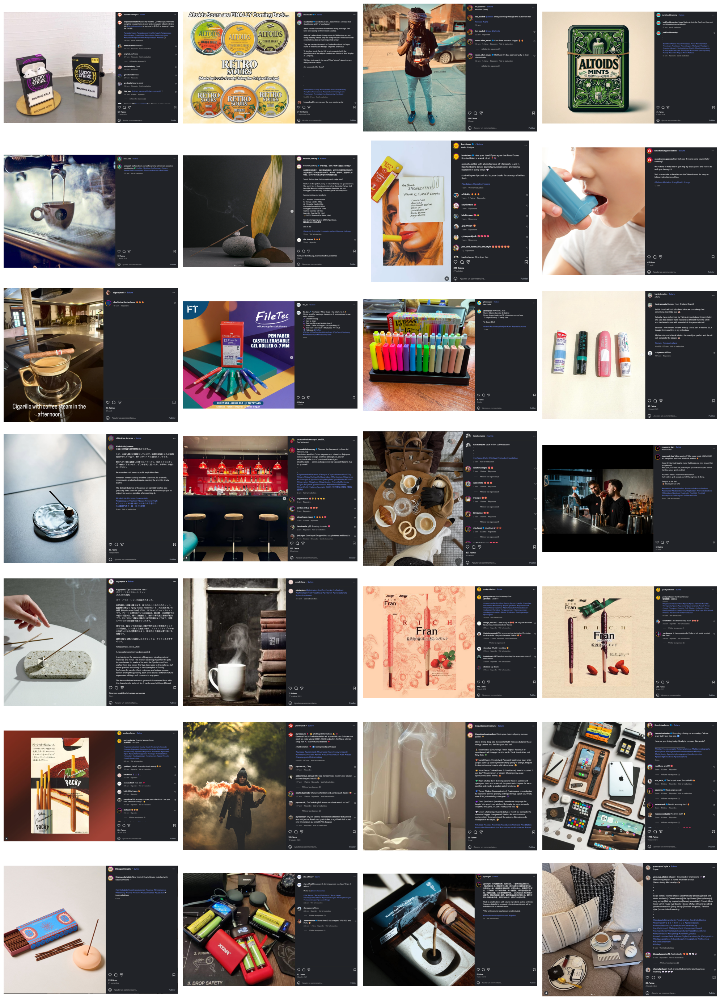

In [30]:
#load images
# Encode all images into a list
base64_images_neg1 = [resize_encode_image(path,resize=2000) for path in image_paths]
num_images = len(base64_images_neg1)
print(f"Found {num_images} images.")

# Example: base64_images is your list of base64-encoded images
cols = 4  # adjust depending on number of images
rows = rows = math.ceil(num_images / cols)

plt.figure(figsize=(20, 4 * rows))
for idx, b64_img in enumerate(base64_images_neg1):
    # Decode base64 to image
    image_data = base64.b64decode(b64_img)
    image = Image.open(io.BytesIO(image_data))
    
    plt.subplot(rows, cols, idx + 1)
    plt.imshow(image)
    plt.axis('off')

plt.tight_layout()
plt.show()

### Online image bank

We saved images from https://unsplash.com/fr.


In [17]:
#load and check dimension

# Folder containing images
image_folder = Path(r"C:/TEMP/projects/omata/data/image_negative_controls/unsplash_batch1")

# Get all image paths
image_paths = list(image_folder.glob("*.jpg")) + \
              list(image_folder.glob("*.jpeg")) + \
              list(image_folder.glob("*.png"))
image_paths.sort()

# Extract file names, open images, and get sizes
file_names_neg2 = [p.name for p in image_paths]
image_sizes = [Image.open(p).size for p in image_paths]  # (width, height)

# Create a DataFrame
df_images = pd.DataFrame({
    "file_name": file_names_neg2,
    "width": [s[0] for s in image_sizes],
    "height": [s[1] for s in image_sizes]
})

# Display the DataFrame
print(df_images)

                                            file_name  width  height
0              2-bro-s-media-LfUXV5gMDfs-unsplash.jpg   5184    3323
1                        a-l-6ElnH17iD-8-unsplash.jpg   2836    4254
2                 afiq-fatah-jFMAz9hHeY8-unsplash.jpg   2516    3774
3             afiq-fatah-WW7o27qA0rk-unsplash (1).jpg   3373    5059
4             astrid-kennedy-eZ8Nef0DaQU-unsplash.jpg   2592    1944
5               brett-jordan-rJVflgqasr4-unsplash.jpg   4952    3888
6                   d-sarver-v-DjFXZx2DE-unsplash.jpg   2400    3000
7               dima-solomin-GS8rKD8lJKI-unsplash.jpg   4000    6000
8                douglasalan-4Sdb3-knTcg-unsplash.jpg   5760    8640
9   ehimetalor-akhere-unuabona-fateqKwVihs-unsplas...   4000    6000
10               elbert-lora-38spGSpPTpE-unsplash.jpg   3890    5835
11               h-ng-nguy-n-99Kd2vWuXZs-unsplash.jpg   4000    6000
12               ike-ellyana-oOs72WMT5sA-unsplash.jpg   2912    5184
13                ivan-lenin-cK7hH

['2-bro-s-media-LfUXV5gMDfs-unsplash.jpg', 'a-l-6ElnH17iD-8-unsplash.jpg', 'afiq-fatah-jFMAz9hHeY8-unsplash.jpg', 'afiq-fatah-WW7o27qA0rk-unsplash (1).jpg', 'astrid-kennedy-eZ8Nef0DaQU-unsplash.jpg', 'brett-jordan-rJVflgqasr4-unsplash.jpg', 'd-sarver-v-DjFXZx2DE-unsplash.jpg', 'dima-solomin-GS8rKD8lJKI-unsplash.jpg', 'douglasalan-4Sdb3-knTcg-unsplash.jpg', 'ehimetalor-akhere-unuabona-fateqKwVihs-unsplash.jpg', 'elbert-lora-38spGSpPTpE-unsplash.jpg', 'h-ng-nguy-n-99Kd2vWuXZs-unsplash.jpg', 'ike-ellyana-oOs72WMT5sA-unsplash.jpg', 'ivan-lenin-cK7hHHLyq3Y-unsplash.jpg', 'james-adams-dfoK0qs1AsE-unsplash.jpg', 'james-adams-Ry26kbchzqc-unsplash.jpg', 'kalisa-veer-PyfOOdJGLd0-unsplash.jpg', 'kawe-rodrigues-bAXL_Y7r-X4-unsplash.jpg', 'l-ch-U9KrXvWS9GA-unsplash.jpg', 'marta-zuborski-A5X487eiYIU-unsplash.jpg', 'mathilde-langevin-ilsiTpdYTxw-unsplash.jpg', 'mehrab-zahedbeigi-EaBqqyOAuqQ-unsplash.jpg', 'mike-marrah-8687b4ITjhA-unsplash.jpg', 'natali-hordiiuk-OQ22StkuTvI-unsplash.jpg', 'rajat-verma

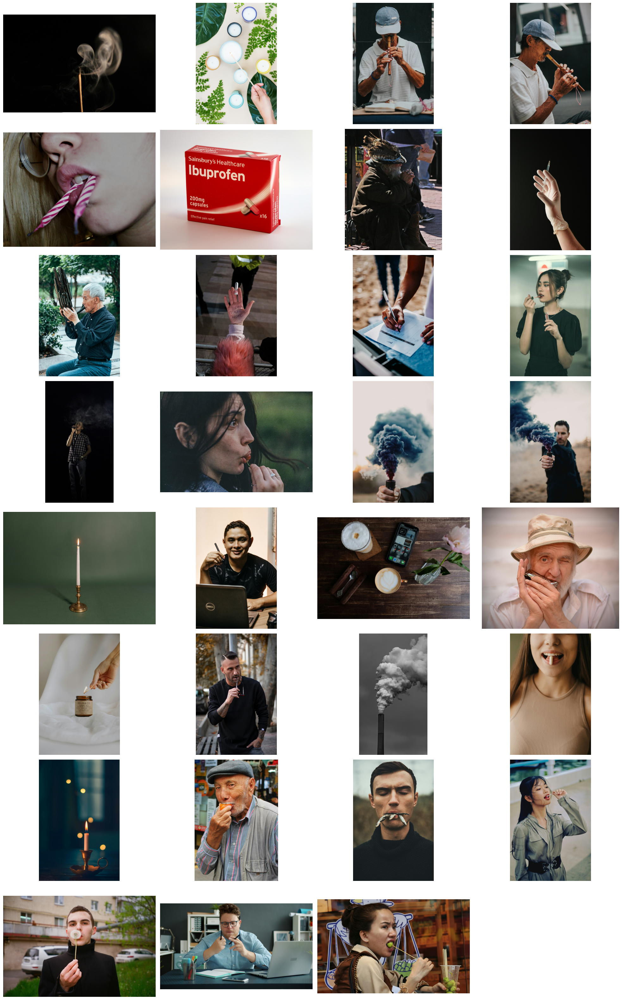

In [8]:

# Encode all images into a list
base64_images_neg2 = [encode_image(path) for path in image_paths]
num_images = len(base64_images_neg2)
print(f"Found {num_images} images.")

# Example: base64_images is your list of base64-encoded images
cols = 4  # adjust depending on number of images
rows = rows = math.ceil(num_images / cols)

plt.figure(figsize=(20, 4 * rows))
for idx, b64_img in enumerate(base64_images_neg2):
    # Decode base64 to image
    image_data = base64.b64decode(b64_img)
    image = Image.open(io.BytesIO(image_data))
    
    plt.subplot(rows, cols, idx + 1)
    plt.imshow(image)
    plt.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
#resize images


# Model test
## 1 image
This should be used as a minial working example to test any new model.

In [14]:
#define function: image

import requests

def analyze_image(base64_image: str, model_name: str, instruction_text: str, api_key: str):
    """
    Send a base64-encoded image to the OpenAI API with a text instruction.

    Args:
        base64_image (str): Base64-encoded image.
        model_name (str): Model to use, e.g., 'gpt-4o'.
        instruction_text (str): Instruction/prompt for the model.
        api_key (str): OpenAI API key.

    Returns:
        str: Model's response.
    """
    # Prepare content
    content = [
        {"type": "text", "text": instruction_text},
        {"type": "image_url", "image_url": {"url": f"data:image/jpeg;base64,{base64_image}"}}
    ]
    
    # Set headers
    headers = {
        "Content-Type": "application/json",
        "Authorization": f"Bearer {api_key}"
    }
    
    # Create payload
    payload = {
        "model": model_name,
        "messages": [{"role": "user", "content": content}],
        "max_tokens": 600
    }
    
    # Make API request
    response = requests.post("https://api.openai.com/v1/chat/completions", headers=headers, json=payload)
    response.raise_for_status()  # raise an error if request failed
    
    return response.json()["choices"][0]["message"]["content"]

In [15]:
#run function

#image
image_path = r"C:/TEMP/projects/omata/data/image_negative_controls/instagram_batch1/instagram_altoids1.png"
base64_image = encode_image(image_path)
#model
model_name = "gpt-4o"
#prompt
instruction_text = "Does this image display tobacco product? (Yes or No)"

result = analyze_image(base64_image, model_name, instruction_text, api_key)
print(result)

No, this image does not display a tobacco product.


## Multiple images


In [19]:
#define function: multiple images

def analyze_mult_images(base64_images: list, model_name: str, instruction_text: str, api_key: str):
    """
    Send a base64-encoded image to the OpenAI API with a text instruction.

    Args:
        base64_image (str): Base64-encoded image.
        model_name (str): Model to use, e.g., 'gpt-4o'.
        instruction_text (str): Instruction/prompt for the model.
        api_key (str): OpenAI API key.

    Returns:
        str: Model's response.
    """
    # Prepare content
    content = [
                {"type": "text", "text": instruction_text},
            ] + [
                {"type": "image_url", "image_url": {"url": f"data:image/jpeg;base64,{b64}"}} 
                for b64 in base64_images
            ]
    
    # Set headers
    headers = {
        "Content-Type": "application/json",
        "Authorization": f"Bearer {api_key}"
    }
    
    # Create payload
    payload = {
        "model": model_name,
        "messages": [{"role": "user", "content": content}],
        "max_tokens": 600
    }
    
    # Make API request
    response = requests.post("https://api.openai.com/v1/chat/completions", headers=headers, json=payload)
    response.raise_for_status()  # raise an error if request failed
    
    return response.json()["choices"][0]["message"]["content"]

In [20]:
#run function

#image
base64_images_test = base64_images[:2] #already encoded
#model
model_name = "gpt-4o"
#prompt
instruction_text =  "Analyze these images. For each, answer: Yes or No if it shows a tobacco product."

result = analyze_mult_images(base64_images_test, model_name, instruction_text, api_key)
print(result)




1. Yes
2. No


## Model with label
and more complex prompt

In [41]:
#define function
def analyze_mult_images_label(base64_images: list, img_names: list, model_name: str, instruction_text: str, api_key: str):
    # Build content with numbered images
    content = [{"type": "text", "text": instruction_text}]
    for img_name, b64 in zip(img_names, base64_images):
        content.append({"type": "text", "text": img_name})  # label
        content.append({"type": "image_url", "image_url": {"url": f"data:image/jpeg;base64,{b64}"}})

    # Set headers
    headers = {
        "Content-Type": "application/json",
        "Authorization": f"Bearer {api_key}"
    }
    
    # Create payload
    payload = {
        "model": model_name,
        "messages": [
            {"role": "user", "content": content}
        ],
        "max_tokens": 600,
        "temperature": 0
    }
    
   # Extract response text
    response = requests.post("https://api.openai.com/v1/chat/completions", headers=headers, json=payload)
    response.raise_for_status()  # raise an error if request failed
    
    return response.json()["choices"][0]["message"]["content"]

In [36]:
import random
from math import ceil

# Parameters
batch_size = 2  # adjust how many images per batch

# Flatten the lists and names if needed
all_images = base64_images_neg2 + base64_images_pos1 + base64_images_neg1 # combine your lists
all_names = file_names_neg2 + file_names_pos1  + file_names_neg1        # combine the corresponding names


# Randomly shuffle
combined = list(zip(all_images[:5], all_names[:5]))
random.shuffle(combined)
all_images, all_names = zip(*combined)  # unzip back

print(all_images)
print(all_names)

# Process in batches
num_batches = ceil(len(all_images) / batch_size)
print(num_batches)

for i in range(num_batches):
    batch_images = all_images[i*batch_size:(i+1)*batch_size]
    batch_names = all_names[i*batch_size:(i+1)*batch_size]
    
    # Call your function for this batch
    result = analyze_mult_images_label(
        [batch_images],  # wrap in list if function expects a list of lists
        [batch_names],   # same here
        model_name,
        instruction_text,
        api_key
    )
    
    print(f"Batch {i+1}/{num_batches} result:")
    print(result)
    print("-"*50)

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [42]:
#apply function

#image
base64_images = [base64_images_neg2,base64_images_neg2,base64_images_pos1] #base64_images_neg2[:2] #[:28]
img_names = [file_names_neg1,file_names_neg2,file_names_pos1] #file_names_neg2[:2]
print(img_names)
print("-")

#model
model_name = "gpt-4o-mini"

#prompt
instruction_text = """For each image below, respond in JSON format mapping each image name to an object with:
- "tobacco_product": "Yes" if a tobacco product is detected, "No" otherwise
- "type": If "tobacco_product" is "Yes", indicate the specific type (e.g., "cigarettes", "box of cigarettes", "cigar", "puff", "vape", "snus", "chewing tobacco", "hookah", "rolling tobacco", "e-cigarette", etc.). If "tobacco_product" is "No", put "NA"

Example output:
{
  "image1_instagram.jpg": {"tobacco_product": "Yes", "type": "cigarettes"},
  "james_blabla.jpg": {"tobacco_product": "No", "type": "NA"}
}"""

result = analyze_mult_images_label(base64_images, img_names, model_name, instruction_text, api_key)
print(result)

['2-bro-s-media-LfUXV5gMDfs-unsplash.jpg', 'a-l-6ElnH17iD-8-unsplash.jpg']
```json
{
  "2-bro-s-media-LfUXV5gMDfs-unsplash.jpg": {"tobacco_product": "No", "type": "NA"},
  "a-l-6ElnH17iD-8-unsplash.jpg": {"tobacco_product": "No", "type": "NA"}
}
```


## Results 

In [40]:
#save results
import json
import pandas as pd
import re

#remove json text at the beginning that gpt is adding
cleaned = re.sub(r'```json|```', '', text_response).strip()

# Convert to Python dict
answers = json.loads(cleaned)

# Loop to create rows
rows = []
for label, info in answers.items():
    # info is a dict like {"tobacco_product": "Yes", "type": "box of cigarettes"}
    row = {"image_id": label}  # first column = image label
    row.update(info)           # add all inner dict items as separate columns
    rows.append(row)

# Convert to DataFrame
df = pd.DataFrame(rows)
print(df)
#df.to_csv("results/classification/instagram_neg_controls_metric1.csv", index=False)

  image_id tobacco_product               type
0  Image 1             Yes  box of cigarettes
1  Image 2              No                 NA
